In [1]:
import torch
import glob
import os
import itertools
import matplotlib.pyplot as plt
import numpy as np

from monai.transforms import Compose, LoadImage, MapLabelValue


2024-04-25 16:42:53.704057: I external/local_tsl/tsl/cuda/cudart_stub.cc:31] Could not find cuda drivers on your machine, GPU will not be used.
2024-04-25 16:42:53.983804: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-04-25 16:42:53.983891: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-04-25 16:42:54.008930: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-04-25 16:42:54.085863: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructio

In [5]:
data_dir_source = '../other/MR_withGT_proc/annotated'
# data_dir_target = '../other/CT_withGT_proc/annotated'
data_dir_target = '../other/CT_fake_repr_all_concat_899/reproduce_all'

In [3]:
res = np.array([0.7202185, 0.49251437, 0.67937, 0.46284723])
print("Mean: ", np.mean(res))
print("STD: ", np.std(res))

Mean:  0.588737525
STD:  0.1124819477126411


In [7]:
def get_datasets(fold):
    all_source_images = sorted(glob.glob(os.path.join(data_dir_source, "images/case_10*")))
    all_source_labels = sorted(glob.glob(os.path.join(data_dir_source, "labels/case_10*")))
    
    all_target_images = sorted(glob.glob(os.path.join(data_dir_target, "images/case_10*")))
    all_target_labels = sorted(glob.glob(os.path.join(data_dir_target, "labels/case_10*")))

    images_source = [glob.glob(all_source_images[idx]+ "/*.nii.gz") for idx in fold]
    images_source = sorted(list(itertools.chain.from_iterable(images_source)))
    labels_source = [glob.glob(all_source_labels[idx]+ "/*.nii.gz") for idx in fold]
    labels_source = sorted(list(itertools.chain.from_iterable(labels_source)))
    
    images_target = [glob.glob(all_target_images[idx]+ "/*.nii.gz") for idx in fold]
    images_target = sorted(list(itertools.chain.from_iterable(images_target)))
    labels_target = [glob.glob(all_target_labels[idx]+ "/*.nii.gz") for idx in fold]
    labels_target = sorted(list(itertools.chain.from_iterable(labels_target)))

    return images_source, labels_source, images_target, labels_target


In [ ]:
def print_filenames(images_source, labels_source, images_target, labels_target):
    print("Source images: ", images_source)
    print("Source labels: ", labels_source)

    print("Target images: ", images_target)
    print("Target labels: ", labels_target)
    

In [18]:
def visualize_fold(images_source, name):
    print(name)
    plt.figure(figsize=(16, 12))
    for i in range(48):
        plt.subplot(6, 8, i + 1)
        plt.axis("off")
        if i < len(images_source):
            plt.imshow(LoadImage()(images_source[i]).squeeze(), cmap='gray')
    plt.show()
 
        
        

In [4]:
data_dir = '../other/CT_fake_repr_all_concat_899/reproduce_all'

# Visualize Test data

48
TARGET IMAGES CASE 18


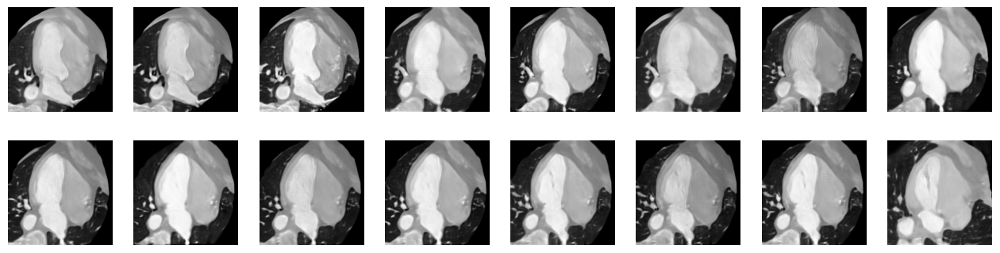

TARGET IMAGES CASE 19


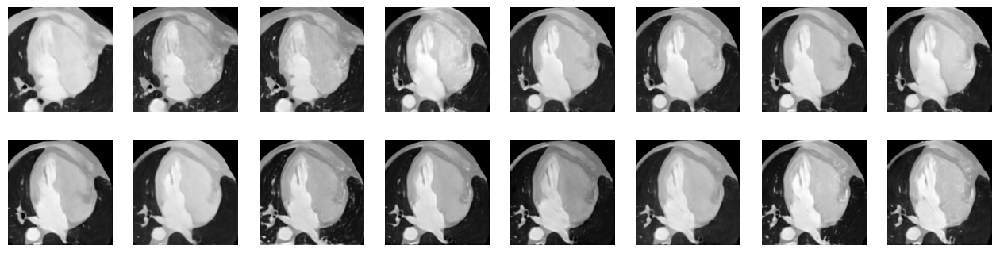

In [14]:
test_folds = [16]
images_source_18, labels_source_18, images_target_18, labels_target_18 = get_datasets(test_folds)

# print_filenames(images_source_test, labels_source_test, images_target_test, labels_target_test)
# visualize_fold(images_source_18, name="SOURCE IMAGES CASE 18")
print(len(images_target_18))
visualize_fold(images_target_18, name="TARGET IMAGES CASE 18")

test_folds = [17]
images_source_19, labels_source_19, images_target_19, labels_target_19 = get_datasets(test_folds)

# print_filenames(images_source_test, labels_source_test, images_target_test, labels_target_test)
# visualize_fsold(images_source_19, name="SOURCE IMAGES CASE 19")
visualize_fold(images_target_19, name="TARGET IMAGES CASE 19")


# Visualize Training/val data

In [ ]:
# [0  1  2  4  5  6  7  8  9 10 11 12 14 17]
train_folds = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17]

for item in train_folds:
    images_source_val, labels_source_val, images_target_val, labels_target_val = get_datasets([item])
    visualize_fold(images_source_val, name="SOURCE IMAGES CASE " + str(item))

TARGET IMAGES CASE 0


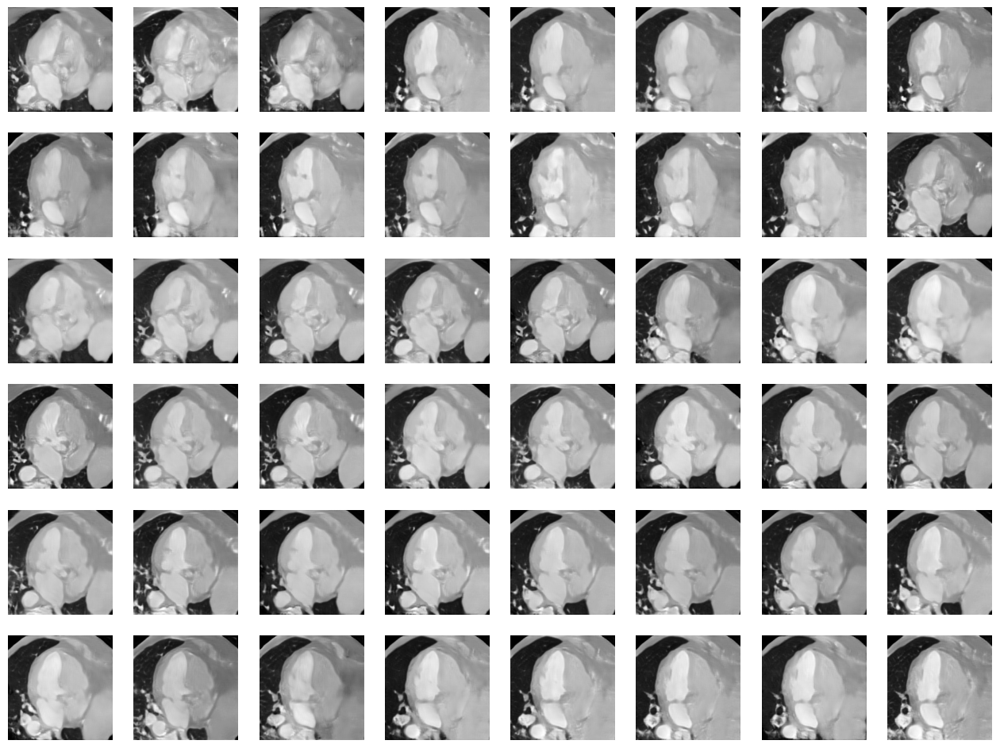

TARGET IMAGES CASE 1


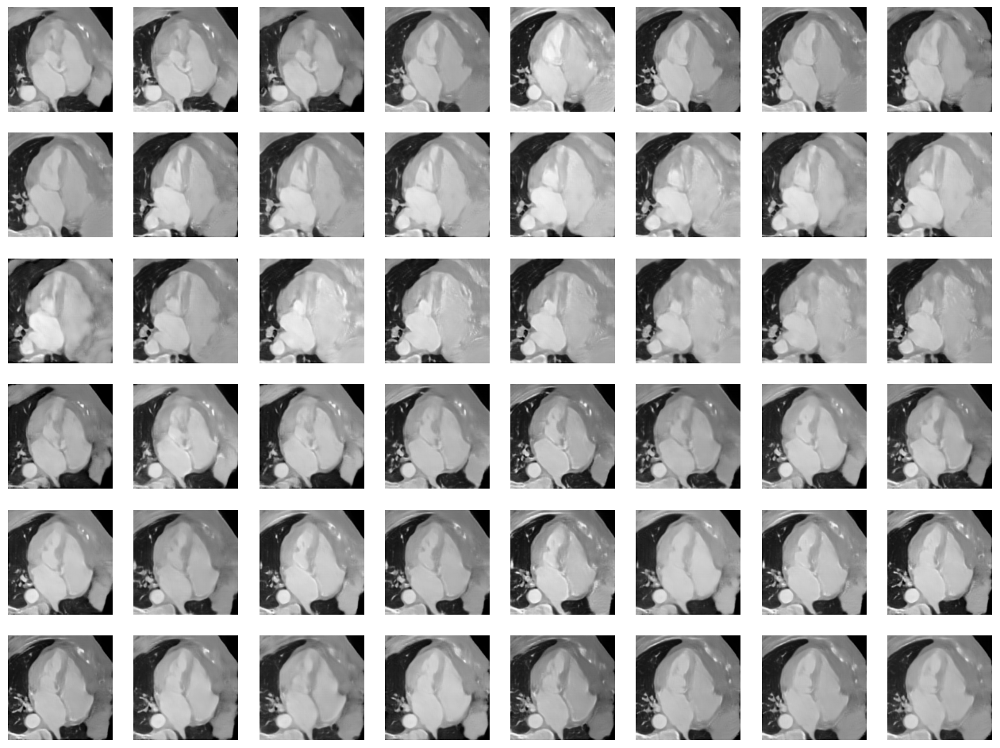

TARGET IMAGES CASE 2


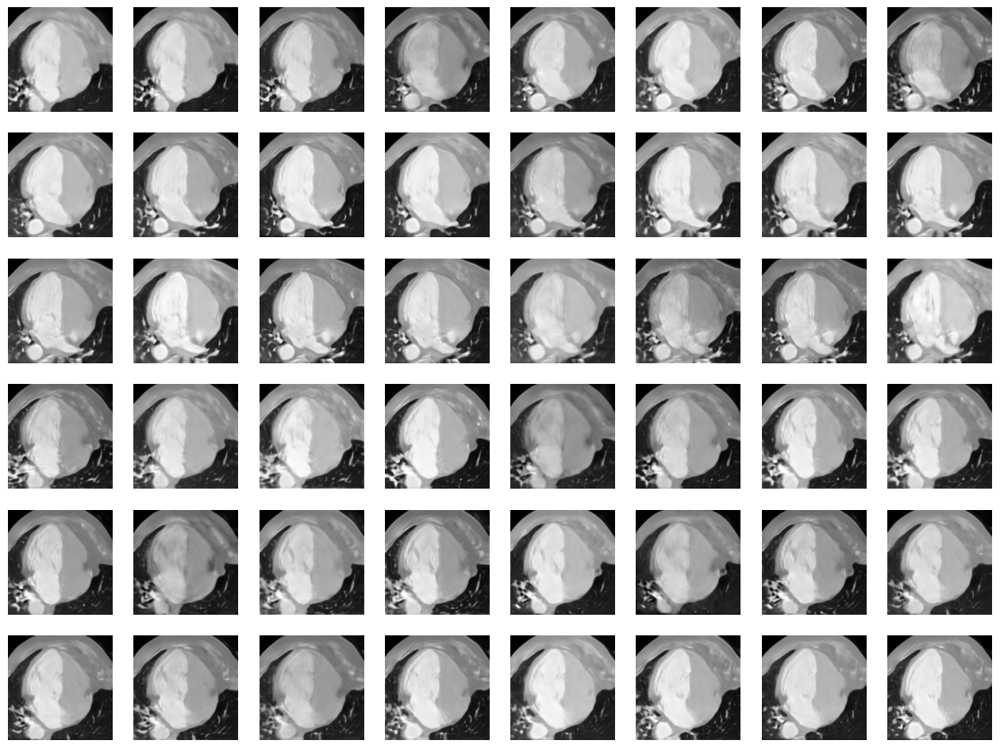

TARGET IMAGES CASE 3


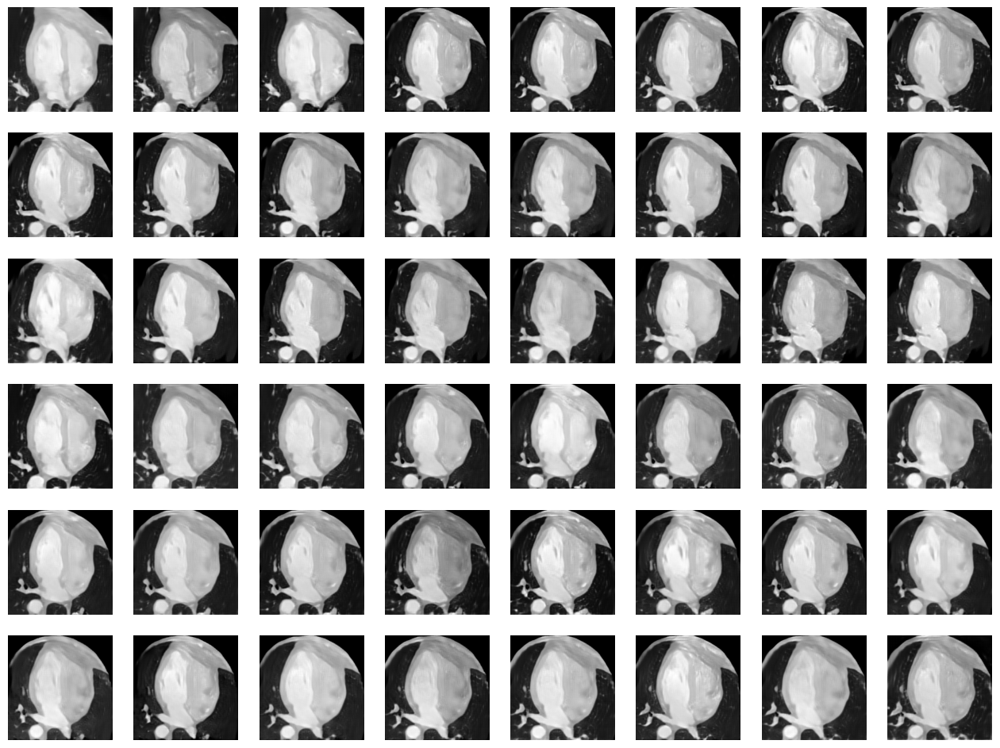

TARGET IMAGES CASE 4


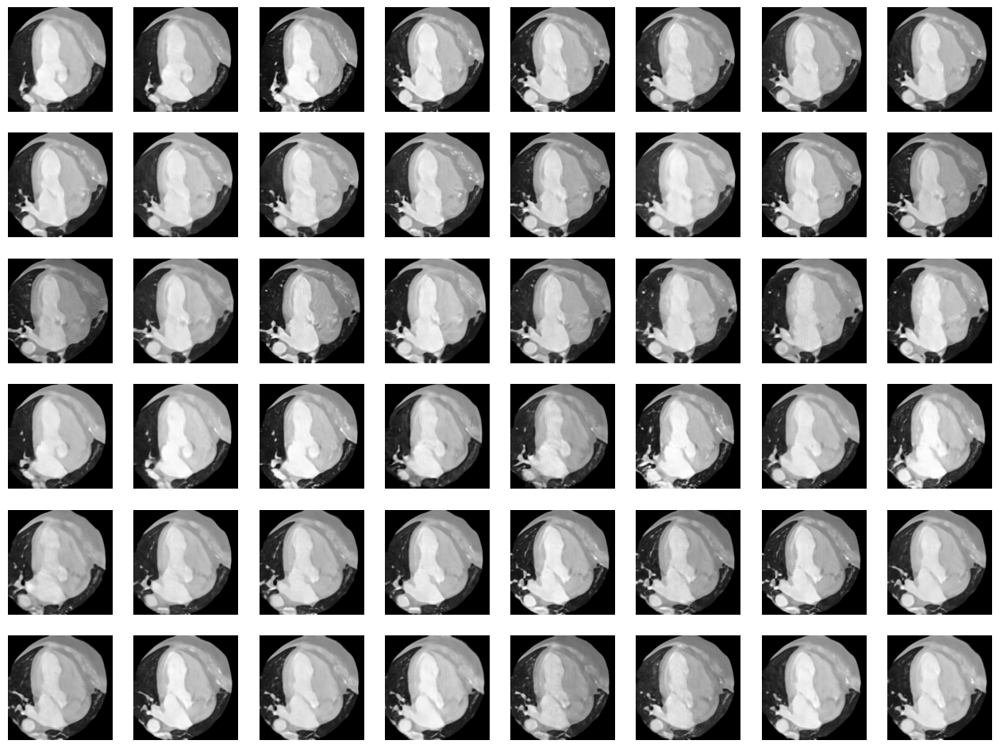

TARGET IMAGES CASE 5


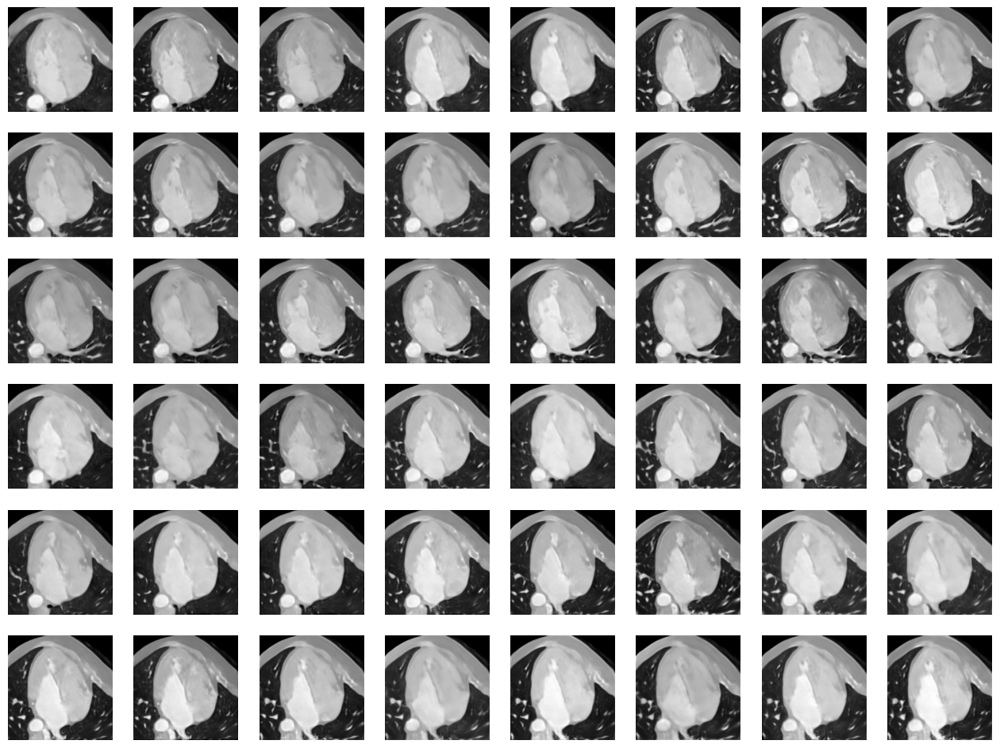

TARGET IMAGES CASE 6


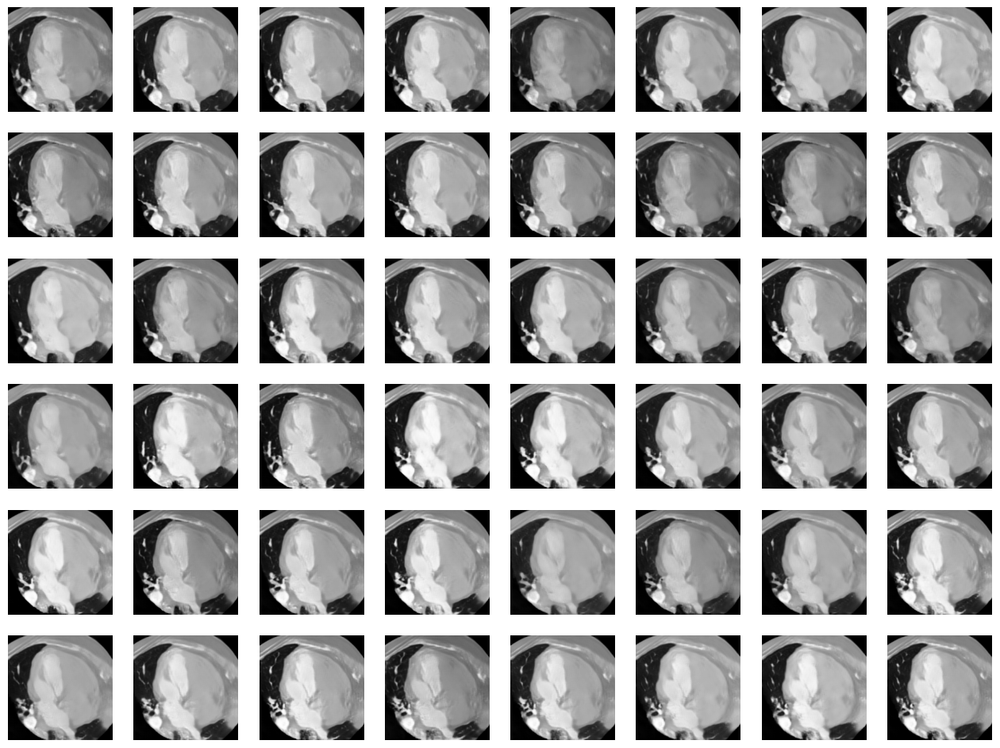

TARGET IMAGES CASE 7


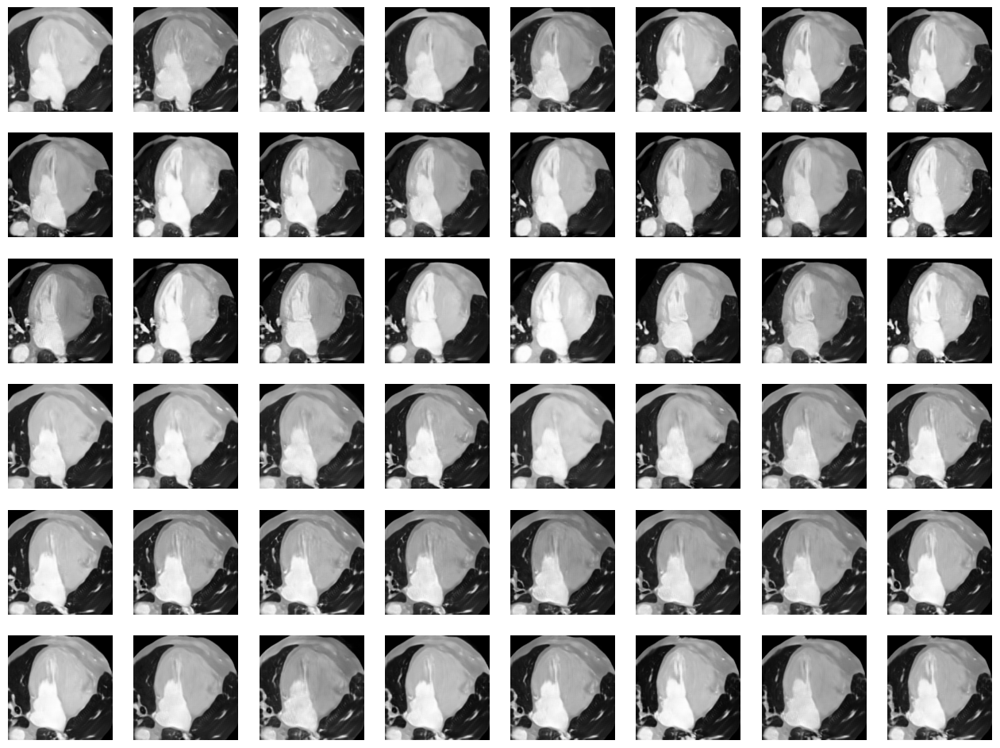

TARGET IMAGES CASE 8


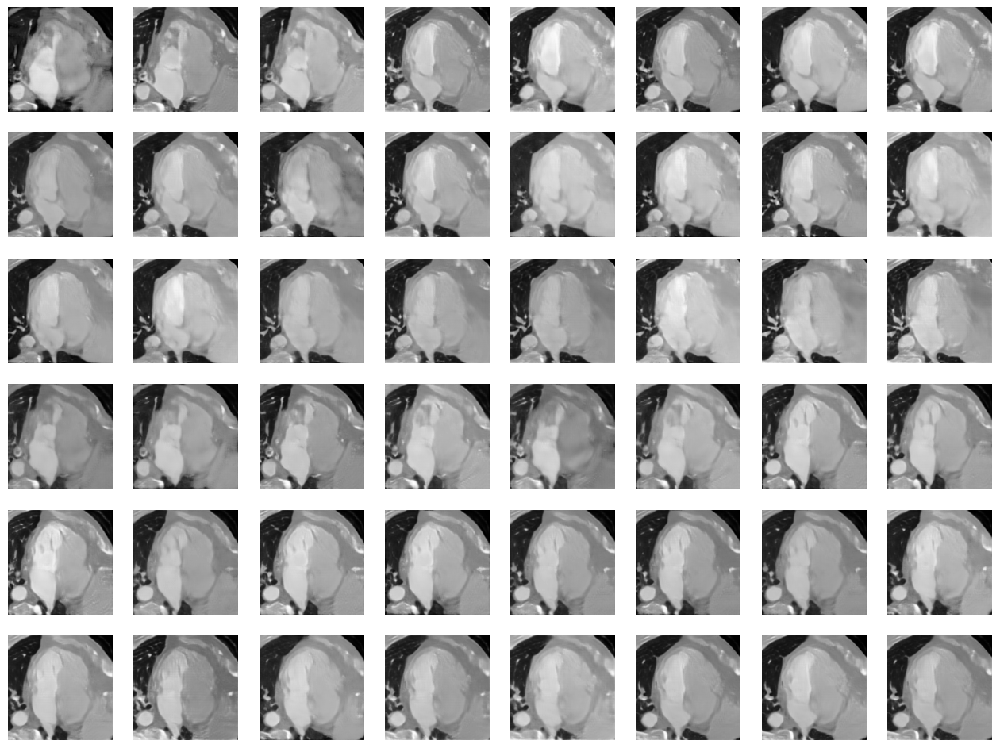

TARGET IMAGES CASE 9


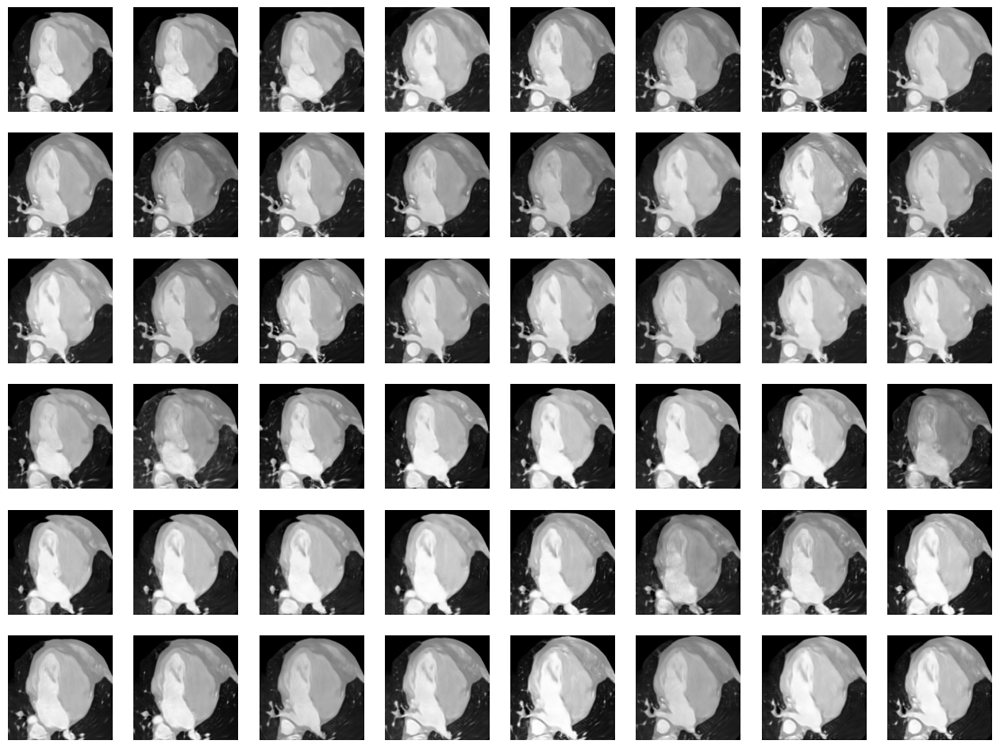

TARGET IMAGES CASE 10


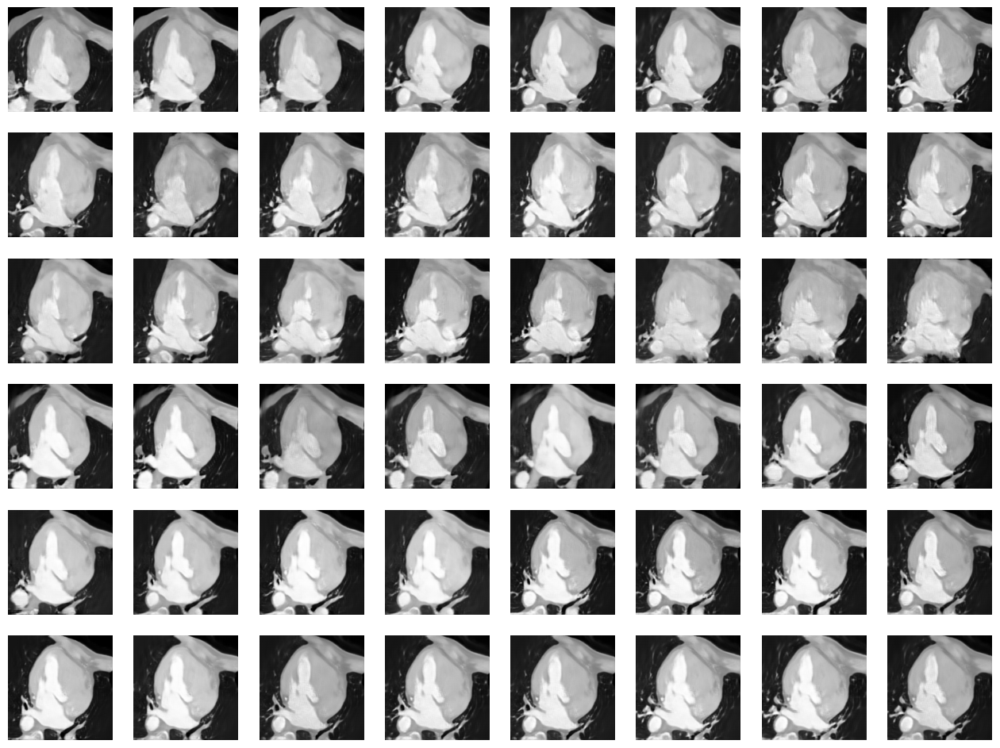

TARGET IMAGES CASE 11


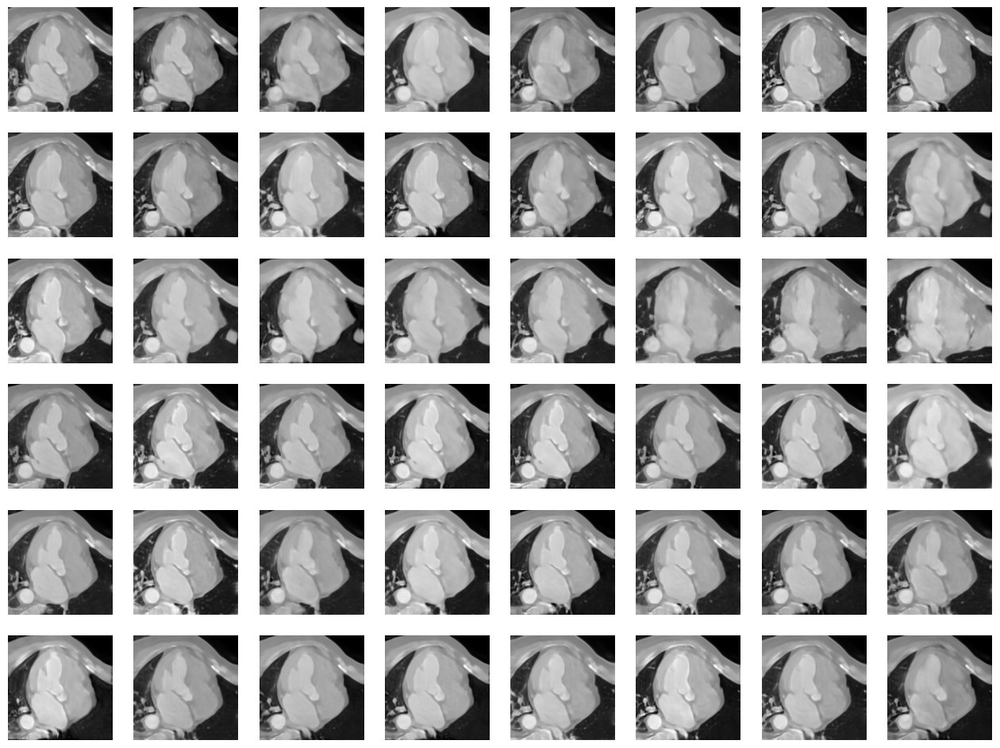

TARGET IMAGES CASE 12


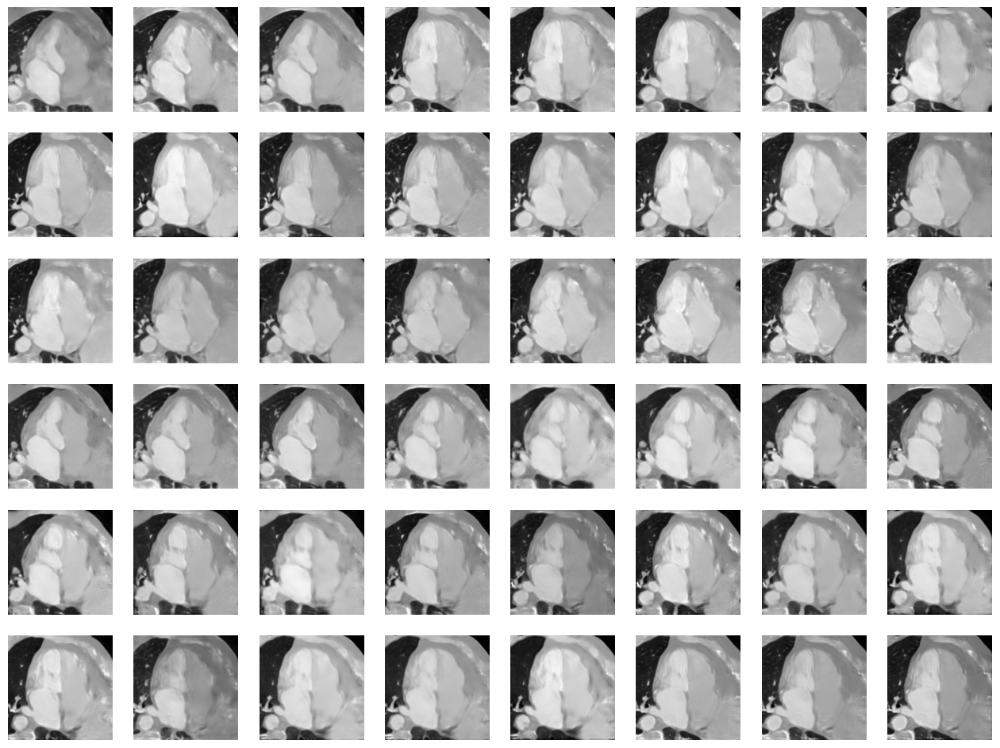

TARGET IMAGES CASE 13


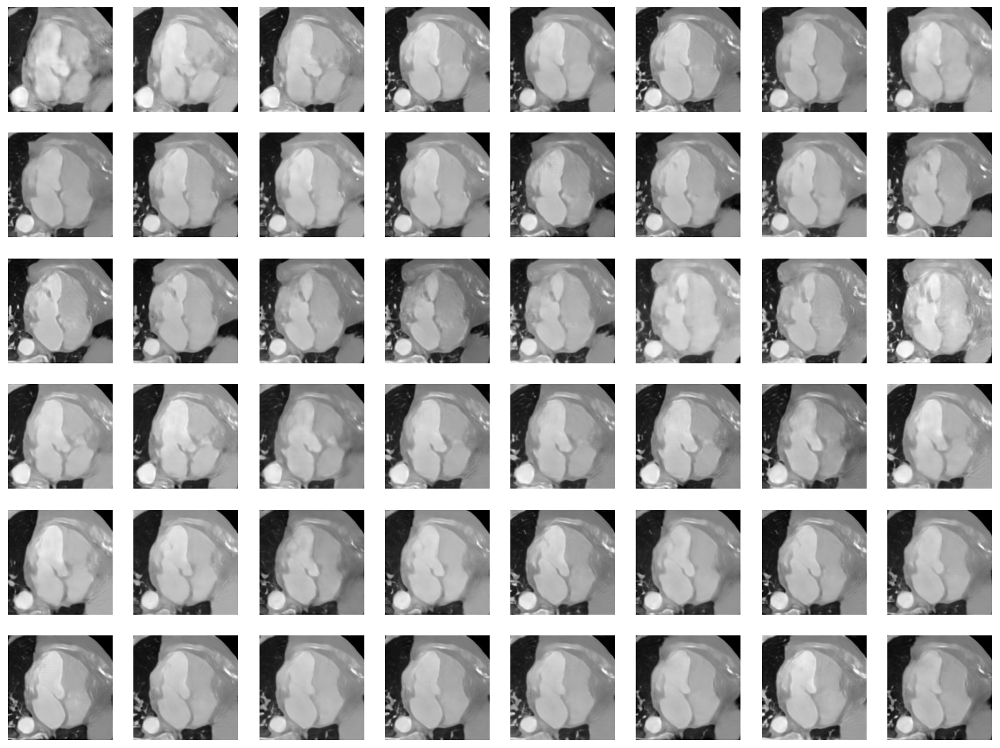

TARGET IMAGES CASE 14


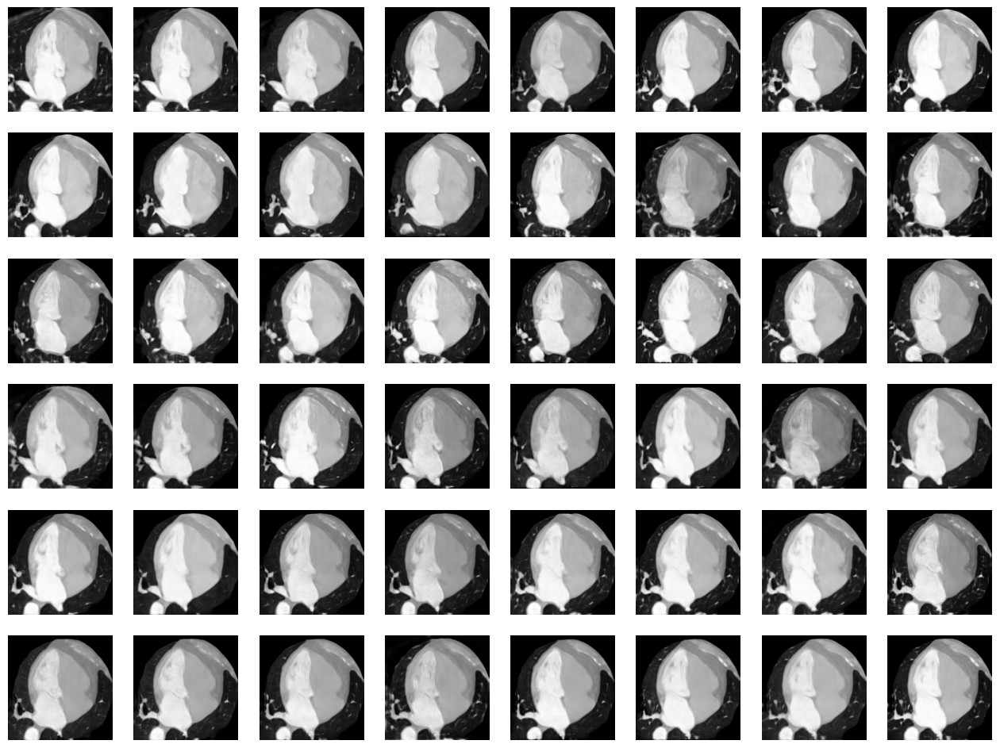

TARGET IMAGES CASE 15


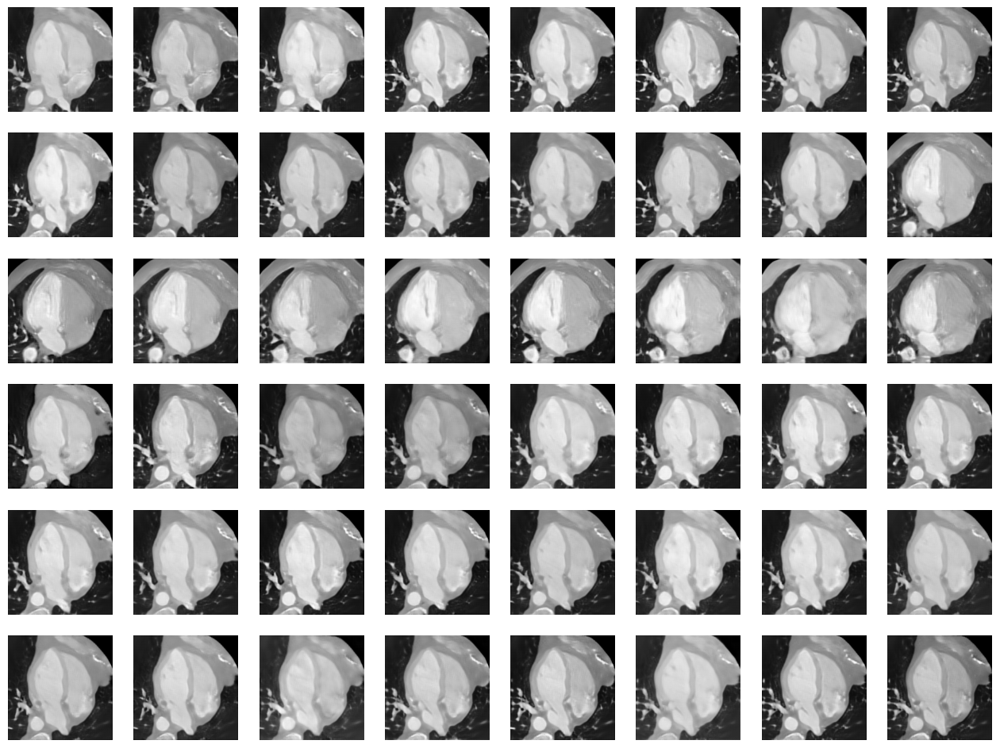

TARGET IMAGES CASE 16


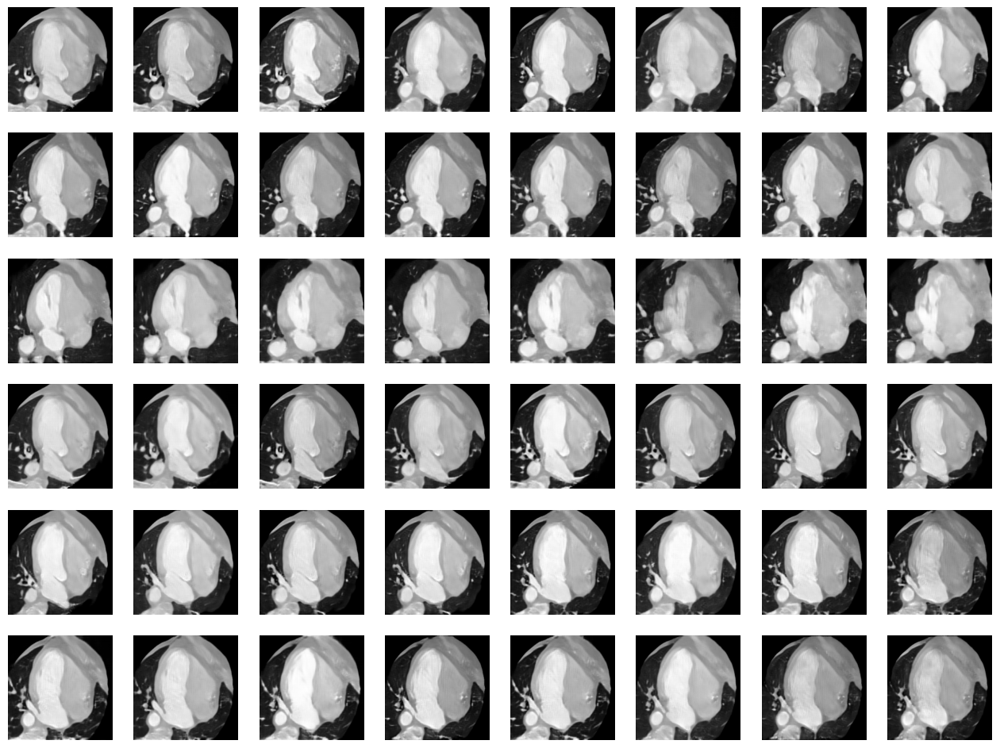

TARGET IMAGES CASE 17


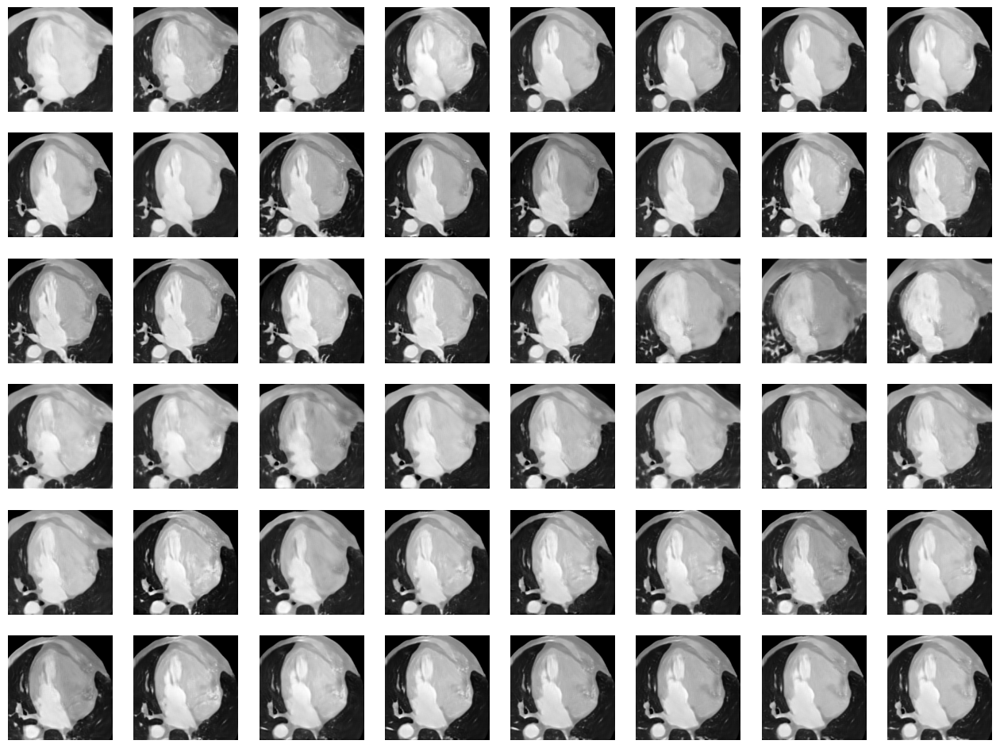

In [19]:
# [0  1  2  4  5  6  7  8  9 10 11 12 14 17]
train_folds = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17]

for item in train_folds:
    images_source_val, labels_source_val, images_target_val, labels_target_val = get_datasets([item])
    visualize_fold(images_target_val, name="TARGET IMAGES CASE " + str(item))

# Visualize Fold 0

SOURCE IMAGES CASE 0


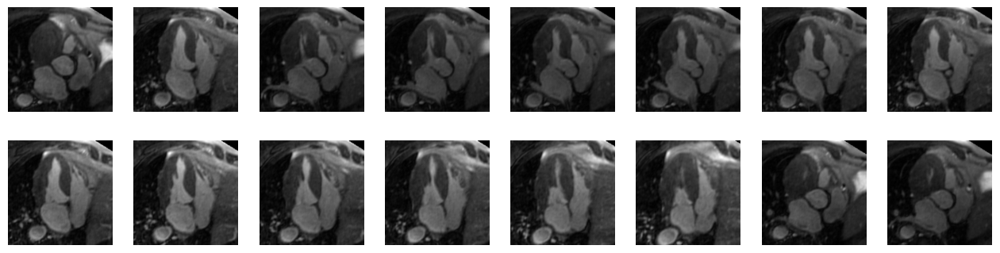

SOURCE IMAGES CASE 1


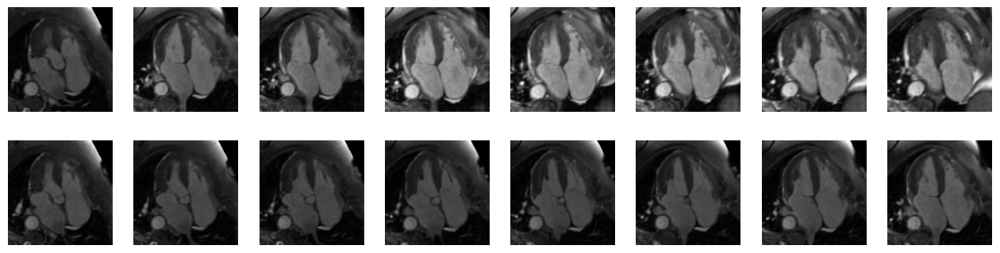

SOURCE IMAGES CASE 5


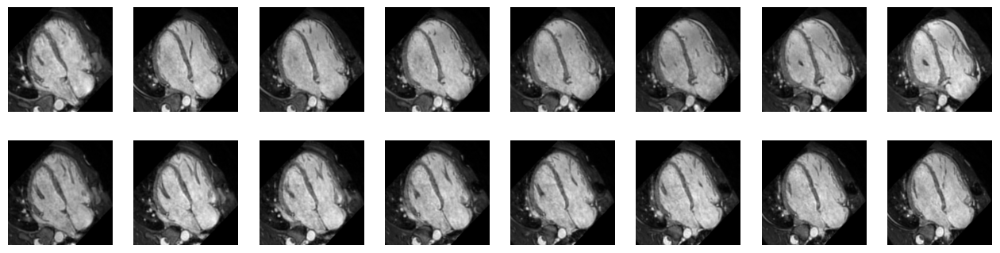

SOURCE IMAGES CASE 8


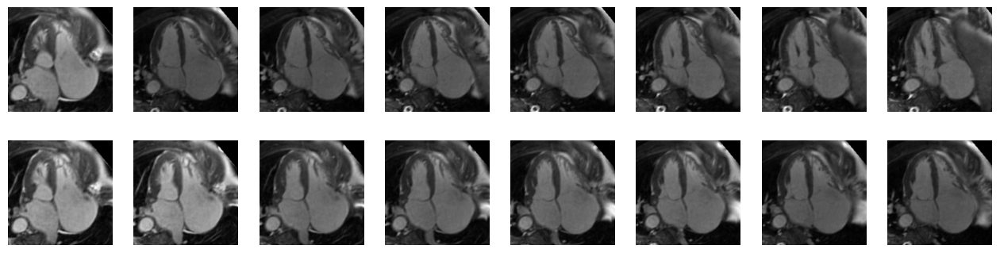

TARGET IMAGES CASE 0


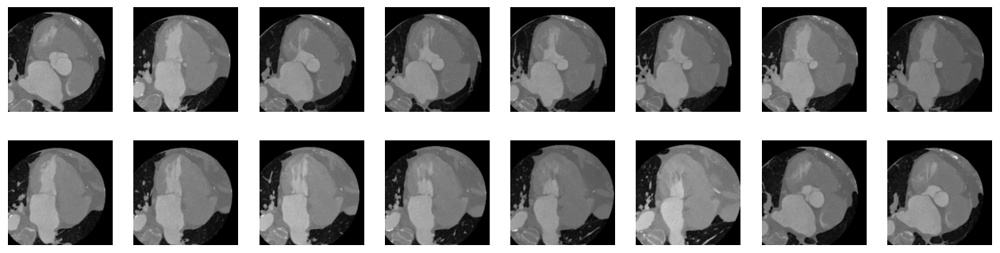

TARGET IMAGES CASE 1


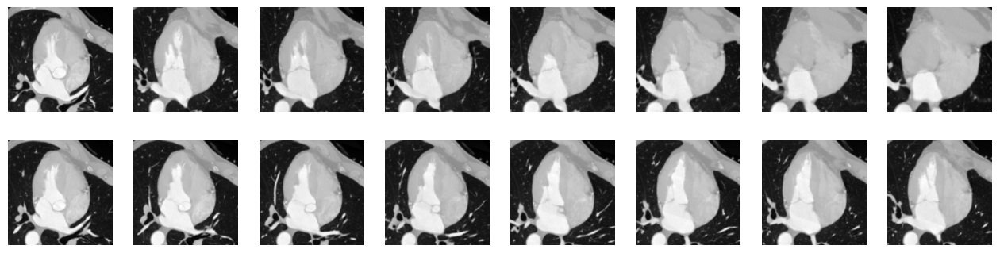

TARGET IMAGES CASE 5


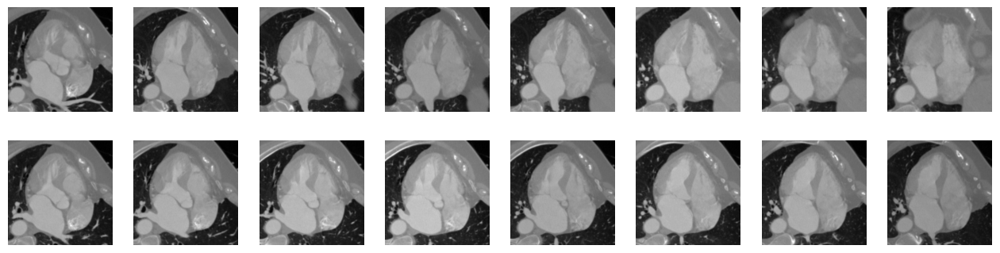

TARGET IMAGES CASE 8


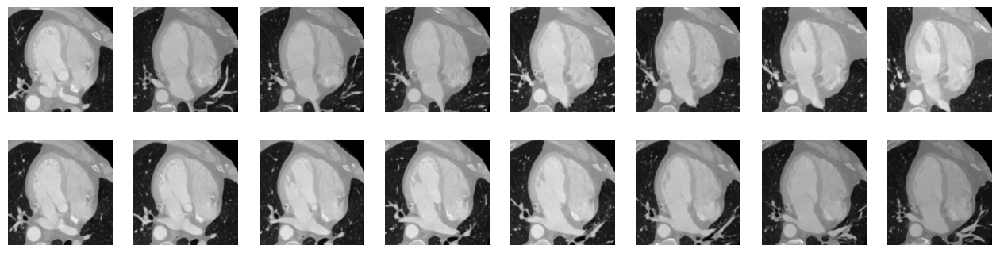

In [48]:
# - Train fold: [ 2  3  4  6  7  9 10 11 12 13 14 15 16 17]
# - Val fold: [0 1 5 8]


val_fold_0 = [0, 1, 5, 8]

for item in val_fold_0:
    images_source_val, labels_source_val, images_target_val, labels_target_val = get_datasets([item])
    visualize_fold(images_source_val, name="SOURCE IMAGES CASE " + str(item))

for item in val_fold_0:
    images_source_val, labels_source_val, images_target_val, labels_target_val = get_datasets([item])
    visualize_fold(images_target_val, name="TARGET IMAGES CASE " + str(item))



In [ ]:
train_fold_0 = [2, 3, 4, 6, 7, 9, 10, 11, 12, 13, 14, 15, 16, 17]
for item in train_folds:
    images_source_val, labels_source_val, images_target_val, labels_target_val = get_datasets([item])
    visualize_fold(images_source_val, name="SOURCE IMAGES CASE " + str(item))

for item in train_folds:
    images_source_val, labels_source_val, images_target_val, labels_target_val = get_datasets([item])
    visualize_fold(images_target_val, name="TARGET IMAGES CASE " + str(item))

# Visualize Fold 1

In [ ]:
# [0  1  2  4  5  6  7  8  9 10 11 12 14 17]
train_folds = [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 17]

for item in train_folds:
    images_source_val, labels_source_val, images_target_val, labels_target_val = get_datasets([item])
    visualize_fold(images_source_val, name="SOURCE IMAGES CASE " + str(item))

for item in train_folds:
    images_source_val, labels_source_val, images_target_val, labels_target_val = get_datasets([item])
    visualize_fold(images_target_val, name="TARGET IMAGES CASE " + str(item))

TARGET IMAGES CASE 3


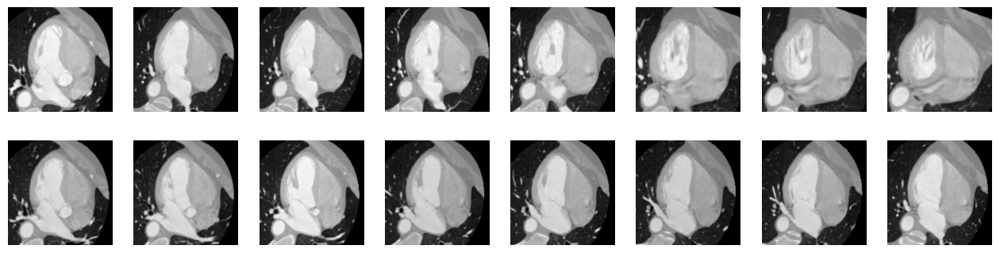

TARGET IMAGES CASE 13


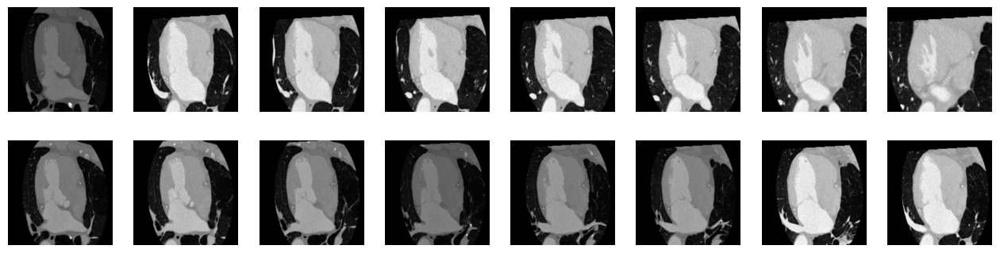

TARGET IMAGES CASE 15


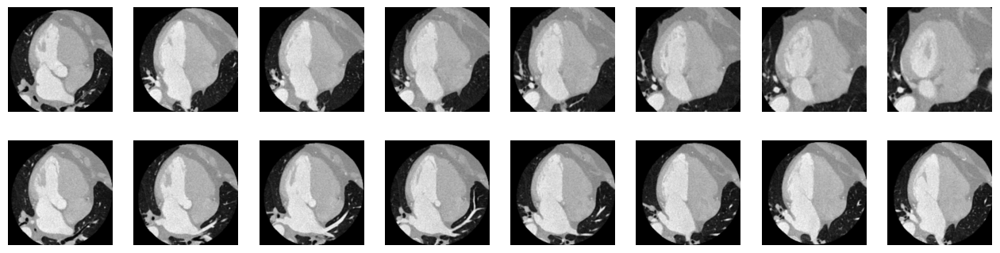

TARGET IMAGES CASE 16


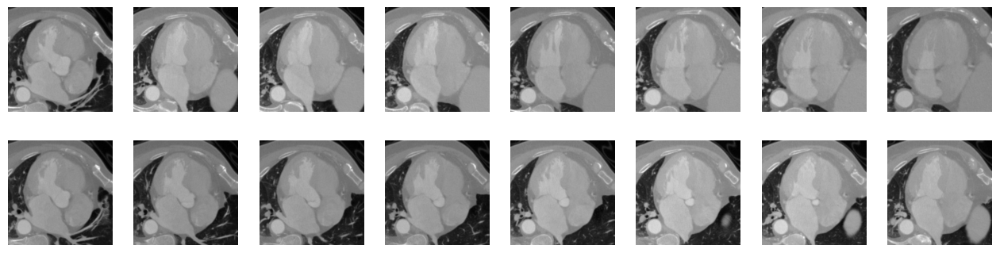

In [44]:
val_folds = [3, 13, 15, 16]

# for item in val_folds:
#     images_source_val, labels_source_val, images_target_val, labels_target_val = get_datasets([item])
#     visualize_fold(images_source_val, name="SOURCE IMAGES CASE " + str(item))

for item in val_folds:
    images_source_val, labels_source_val, images_target_val, labels_target_val = get_datasets([item])
    visualize_fold(images_target_val, name="TARGET IMAGES CASE " + str(item))

# Visualize Fold 2

In [ ]:
val_folds = [2, 9, 11, 17]

for item in val_folds:
    images_source_val, labels_source_val, images_target_val, labels_target_val = get_datasets([item])
    visualize_fold(images_source_val, name="SOURCE IMAGES CASE " + str(item))

for item in val_folds:
    images_source_val, labels_source_val, images_target_val, labels_target_val = get_datasets([item])
    visualize_fold(images_target_val, name="TARGET IMAGES CASE " + str(item))

# Visualize Fold 3

SOURCE IMAGES CASE 4


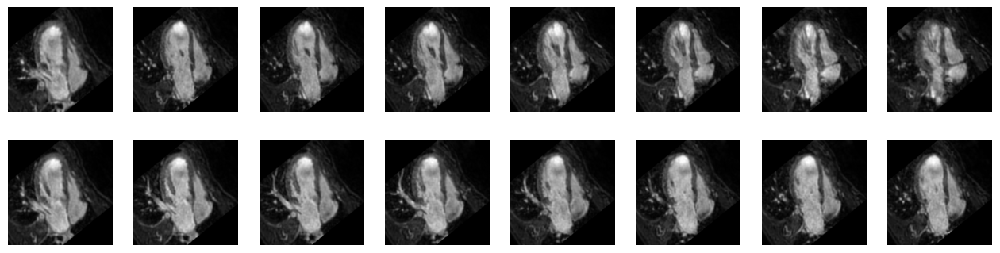

SOURCE IMAGES CASE 7


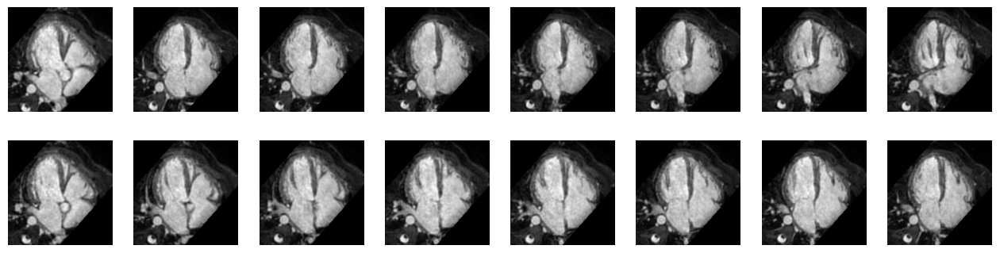

SOURCE IMAGES CASE 12


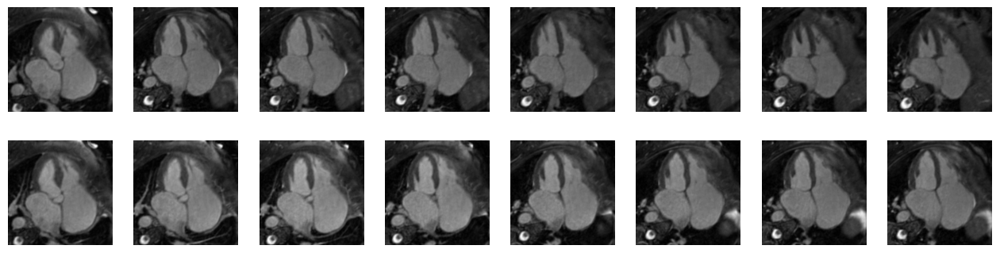

TARGET IMAGES CASE 4


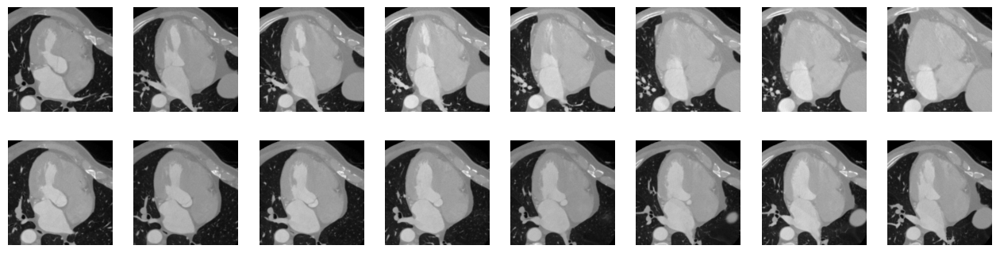

TARGET IMAGES CASE 7


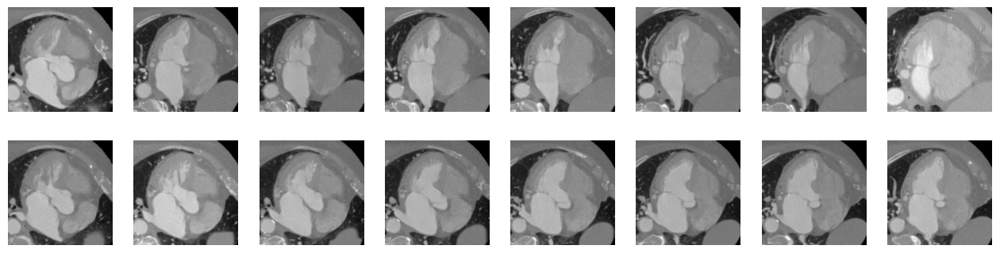

TARGET IMAGES CASE 12


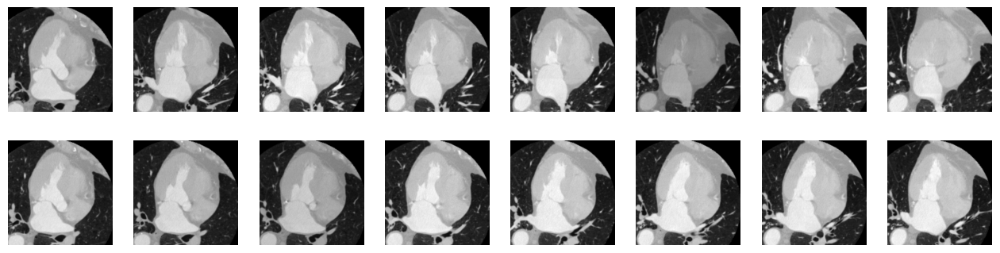

In [45]:
val_folds = [4, 7, 12]

for item in val_folds:
    images_source_val, labels_source_val, images_target_val, labels_target_val = get_datasets([item])
    visualize_fold(images_source_val, name="SOURCE IMAGES CASE " + str(item))

for item in val_folds:
    images_source_val, labels_source_val, images_target_val, labels_target_val = get_datasets([item])
    visualize_fold(images_target_val, name="TARGET IMAGES CASE " + str(item))

In [ ]:
val_folds = [6, 10, 14]

for item in val_folds:
    images_source_val, labels_source_val, images_target_val, labels_target_val = get_datasets([item])
    visualize_fold(images_source_val, name="SOURCE IMAGES CASE " + str(item))

for item in val_folds:
    images_source_val, labels_source_val, images_target_val, labels_target_val = get_datasets([item])
    visualize_fold(images_target_val, name="TARGET IMAGES CASE " + str(item))